In [1]:
%whos

Interactive namespace is empty.


In [2]:
import math
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import tensorflow_addons as tfa
import matplotlib.pyplot as plt
import collections

/Users/karlberb/miniforge3/envs/trnsfrmr/lib/python3.9/site-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


In [3]:
ls *.gz

copy_number.csv.gz  drugs.tsv.gz        experiments.tsv.gz  expression.csv.gz


In [4]:
ls *.csv

genes.csv       mutations.csv   samples.csv     test_data.csv   train_data.csv


### Average counts for duplicate genes

In [5]:
exp_df = pd.read_csv('expression.csv.gz')

In [6]:
exp_df

,entrez_id,improve_sample_id,counts,source,study
0,7105.0,1,4.189825,DepMap,CCLE
1,64102.0,1,0.000000,DepMap,CCLE
2,8813.0,1,6.126601,DepMap,CCLE
3,6359.0,1,2.114367,DepMap,CCLE
4,57147.0,1,2.114367,DepMap,CCLE
...,...,...,...,...,...
32481003,54659.0,1317,0.000000,DepMap,CCLE
32481004,54579.0,1317,0.000000,DepMap,CCLE
32481005,474383.0,1317,0.000000,DepMap,CCLE
32481006,105377063.0,1317,0.000000,DepMap,CCLE


In [7]:
exp_df_lite = exp_df.iloc[:, :3]

In [8]:
del(exp_df)

In [9]:
exp_df_lite

,entrez_id,improve_sample_id,counts
0,7105.0,1,4.189825
1,64102.0,1,0.000000
2,8813.0,1,6.126601
3,6359.0,1,2.114367
4,57147.0,1,2.114367
...,...,...,...
32481003,54659.0,1317,0.000000
32481004,54579.0,1317,0.000000
32481005,474383.0,1317,0.000000
32481006,105377063.0,1317,0.000000


In [ ]:
# Skip to checkpoint file read
e_lst = []
i_lst = []
c_lst = []

for smp_id in exp_df_lite.improve_sample_id.unique(): # Improve sample loop, 1007 total
    # print(smp_id) # <-- wall clock est .5 sec per sample
    sub = exp_df_lite[exp_df_lite.improve_sample_id == smp_id] # df of genes for each improve sample
    single_list = [] # to subset main frame with non-dupe genes
    for index, value in sub.entrez_id.value_counts().items():
        
        if value > 1:

            sub_sub = sub[sub.entrez_id == index]
            e_lst.append(index)
            i_lst.append(smp_id)
            c_lst.append(sub_sub.counts.mean())
        else:
            single_list.append(index)
            
    c_lst = c_lst + list(sub[sub.entrez_id.isin(single_list)].counts)
    i_lst = i_lst + list(sub[sub.entrez_id.isin(single_list)].improve_sample_id)
    e_lst = e_lst + list(sub[sub.entrez_id.isin(single_list)].entrez_id)

In [116]:
# 1 minute runtime
exp_avrgd = pd.DataFrame({'entrez_id': e_lst, 'improve_sample_id': i_lst, 'counts': c_lst})

In [117]:
exp_avrgd # 1.3M dupe rows removed

,entrez_id,improve_sample_id,counts
0,8362.0,1,1.210693
1,8294.0,1,1.210693
2,554313.0,1,1.210693
3,121504.0,1,1.210693
4,8370.0,1,1.210693
...,...,...,...
31104211,54659.0,1317,0.000000
31104212,54579.0,1317,0.000000
31104213,474383.0,1317,0.000000
31104214,105377063.0,1317,0.000000


In [ ]:
31 104 216 # row count

In [119]:
exp_avrgd.to_csv('disk_chkpnts_tssue/exp_avrgd.tsv', sep = '\t')

In [122]:
exp_avrgd

,entrez_id,improve_sample_id,counts
0,8362.0,1,1.210693
1,8294.0,1,1.210693
2,554313.0,1,1.210693
3,121504.0,1,1.210693
4,8370.0,1,1.210693
...,...,...,...
31104211,54659.0,1317,0.000000
31104212,54579.0,1317,0.000000
31104213,474383.0,1317,0.000000
31104214,105377063.0,1317,0.000000


In [11]:
# Checkpoint
exp_avrgd_chk = pd.read_csv('disk_chkpnts_tssue/exp_avrgd.tsv', sep = '\t', index_col = 0)

In [12]:
exp_avrgd_chk

,entrez_id,improve_sample_id,counts
0,8362.0,1,1.210693
1,8294.0,1,1.210693
2,554313.0,1,1.210693
3,121504.0,1,1.210693
4,8370.0,1,1.210693
...,...,...,...
31104211,54659.0,1317,0.000000
31104212,54579.0,1317,0.000000
31104213,474383.0,1317,0.000000
31104214,105377063.0,1317,0.000000


In [123]:
del(exp_avrgd_chk)

In [13]:
exp_avrgd = exp_avrgd_chk

In [14]:
type(exp_avrgd.iloc[0, 2])

numpy.float64

### Find intersection of genes across Improve samples

In [6]:
%whos # devel

Variable        Type         Data/Info
--------------------------------------
collections     module       <module 'collections' fro<...>collections/__init__.py'>
exp_avrgd_chk   DataFrame                entrez_id  im<...>1104216 rows x 3 columns]
keras           module       <module 'keras.api._v2.ke<...>i/_v2/keras/__init__.py'>
layers          module       <module 'keras.api._v2.ke<...>eras/layers/__init__.py'>
math            module       <module 'math' from '/Use<...>th.cpython-39-darwin.so'>
np              module       <module 'numpy' from '/Us<...>kages/numpy/__init__.py'>
pd              module       <module 'pandas' from '/U<...>ages/pandas/__init__.py'>
plt             module       <module 'matplotlib.pyplo<...>es/matplotlib/pyplot.py'>
tf              module       <module 'tensorflow' from<...>/tensorflow/__init__.py'>
tfa             module       <module 'tensorflow_addon<...>flow_addons/__init__.py'>


In [15]:
%whos # checkin pass

Variable        Type         Data/Info
--------------------------------------
c_lst           list         n=2965248
collections     module       <module 'collections' fro<...>collections/__init__.py'>
e_lst           list         n=2935413
exp_avrgd       DataFrame                entrez_id  im<...>1104216 rows x 3 columns]
exp_avrgd_chk   DataFrame                entrez_id  im<...>1104216 rows x 3 columns]
exp_df_lite     DataFrame                entrez_id  im<...>2481008 rows x 3 columns]
i_lst           list         n=2965248
index           float        8263.0
keras           module       <module 'keras.api._v2.ke<...>i/_v2/keras/__init__.py'>
layers          module       <module 'keras.api._v2.ke<...>eras/layers/__init__.py'>
math            module       <module 'math' from '/Use<...>th.cpython-39-darwin.so'>
np              module       <module 'numpy' from '/Us<...>kages/numpy/__init__.py'>
pd              module       <module 'pandas' from '/U<...>ages/pandas/__init__.py'>
plt 

In [7]:
exp_avrgd_chk

,entrez_id,improve_sample_id,counts
0,8362.0,1,1.210693
1,8294.0,1,1.210693
2,554313.0,1,1.210693
3,121504.0,1,1.210693
4,8370.0,1,1.210693
...,...,...,...
31104211,54659.0,1317,0.000000
31104212,54579.0,1317,0.000000
31104213,474383.0,1317,0.000000
31104214,105377063.0,1317,0.000000


### Histogram checks

Text(0.5, 1.0, 'Genes per Improve smaple ID')

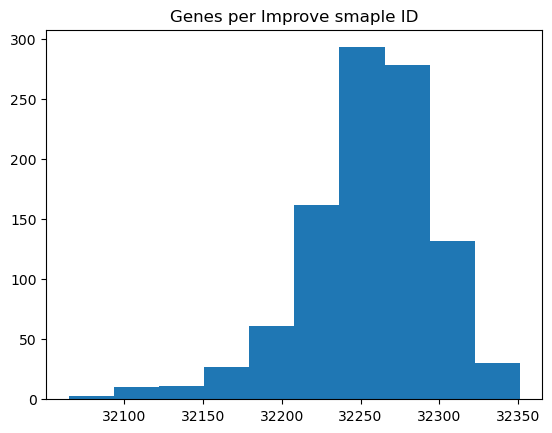

In [43]:
gene_vector_lens_dups = []
for smp_id in exp_df.improve_sample_id.unique():
    sub = exp_df[exp_df.improve_sample_id == smp_id]
    gene_vector_lens_dups.append(len(sub))
plt.hist(gene_vector_lens_dups)
plt.title('Genes per Improve smaple ID')

In [9]:
len(exp_avrgd_chk.improve_sample_id.unique())

1007

Text(0.5, 1.0, 'Genes per Improve smaple ID')

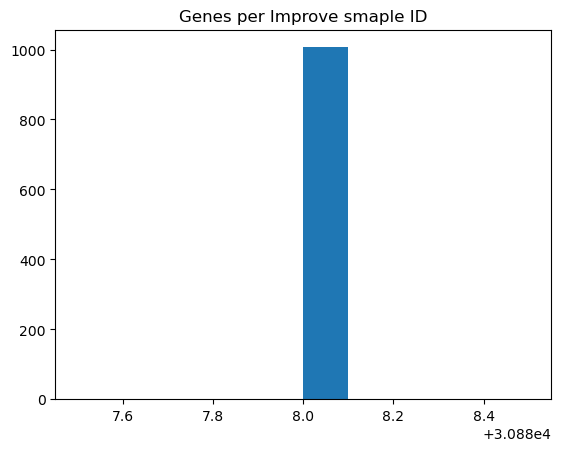

In [8]:
gene_vector_lens = []
for smp_id in exp_avrgd_chk.improve_sample_id.unique():
    sub = exp_avrgd_chk[exp_avrgd_chk.improve_sample_id == smp_id]
    gene_vector_lens.append(len(sub))
plt.hist(gene_vector_lens)
plt.title('Genes per Improve smaple ID')

In [10]:
gene_vectors = []
for smp_id in exp_avrgd_chk.improve_sample_id.unique():
    sub = exp_avrgd_chk[exp_avrgd_chk.improve_sample_id == smp_id]
    sub_gene_list = list(sub.entrez_id)
    gene_vectors.append(sub_gene_list)

In [11]:
ntrsct = set.intersection(*map(set,gene_vectors))

In [12]:
len(ntrsct) # Are some of these non-coding?
            # ~10k more than expected for coding genes

30888

In [13]:
exp_avrgd_chk

,entrez_id,improve_sample_id,counts
0,8362.0,1,1.210693
1,8294.0,1,1.210693
2,554313.0,1,1.210693
3,121504.0,1,1.210693
4,8370.0,1,1.210693
...,...,...,...
31104211,54659.0,1317,0.000000
31104212,54579.0,1317,0.000000
31104213,474383.0,1317,0.000000
31104214,105377063.0,1317,0.000000


In [44]:
check_list = []
cnt_lst = []
for imprv_id in exp_avrgd_chk.improve_sample_id.unique():
    print(imprv_id)
    sub = exp_avrgd_chk[exp_avrgd_chk.improve_sample_id == imprv_id]
    # print(len(sub))
    # break
    check_list.append(list(sub.entrez_id))
    cnt_lst.append(list(sub.counts))
    if imprv_id == 4:
        break

1
2
3
4


(array([1.6963e+04, 1.3740e+03, 9.5300e+02, 9.5900e+02, 1.0810e+03,
        1.1900e+03, 1.4230e+03, 1.5110e+03, 1.5040e+03, 1.3410e+03,
        9.8200e+02, 6.3600e+02, 3.6600e+02, 2.1900e+02, 1.4200e+02,
        6.9000e+01, 4.3000e+01, 3.6000e+01, 3.2000e+01, 3.6000e+01,
        1.9000e+01, 5.0000e+00, 3.0000e+00, 0.0000e+00, 1.0000e+00]),
 array([ 0.        ,  0.59162209,  1.18324417,  1.77486626,  2.36648834,
         2.95811043,  3.54973251,  4.1413546 ,  4.73297668,  5.32459877,
         5.91622086,  6.50784294,  7.09946503,  7.69108711,  8.2827092 ,
         8.87433128,  9.46595337, 10.05757545, 10.64919754, 11.24081962,
        11.83244171, 12.4240638 , 13.01568588, 13.60730797, 14.19893005,
        14.79055214]),
 <BarContainer object of 25 artists>)

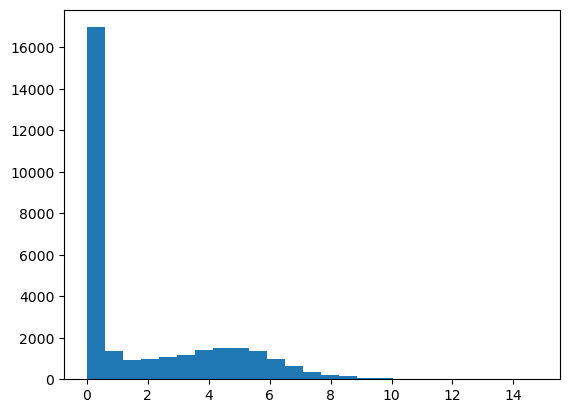

In [49]:
plt.hist(cnt_lst[1], bins = 25)

(array([1.6511e+04, 1.5780e+03, 1.4160e+03, 1.4720e+03, 1.7200e+03,
        1.8560e+03, 1.7760e+03, 1.5280e+03, 1.1510e+03, 7.1500e+02,
        4.5100e+02, 2.8900e+02, 1.3400e+02, 1.0200e+02, 5.3000e+01,
        4.2000e+01, 3.9000e+01, 2.8000e+01, 1.4000e+01, 4.0000e+00,
        4.0000e+00, 2.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+00]),
 array([ 0.        ,  0.65616907,  1.31233815,  1.96850722,  2.6246763 ,
         3.28084537,  3.93701445,  4.59318352,  5.24935259,  5.90552167,
         6.56169074,  7.21785982,  7.87402889,  8.53019796,  9.18636704,
         9.84253611, 10.49870519, 11.15487426, 11.81104334, 12.46721241,
        13.12338148, 13.77955056, 14.43571963, 15.09188871, 15.74805778,
        16.40422685]),
 <BarContainer object of 25 artists>)

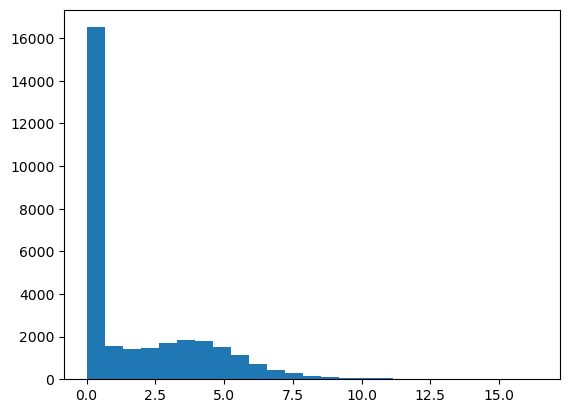

In [50]:
plt.hist(cnt_lst[0], bins = 25)

(array([1.6347e+04, 1.6490e+03, 1.2590e+03, 1.3780e+03, 1.5040e+03,
        1.6930e+03, 1.5920e+03, 1.5620e+03, 1.2740e+03, 9.5000e+02,
        6.1300e+02, 4.1300e+02, 2.7000e+02, 1.3000e+02, 8.9000e+01,
        6.1000e+01, 4.9000e+01, 2.2000e+01, 1.8000e+01, 8.0000e+00,
        4.0000e+00, 2.0000e+00, 0.0000e+00, 0.0000e+00, 1.0000e+00]),
 array([ 0.        ,  0.64330675,  1.28661351,  1.92992026,  2.57322701,
         3.21653377,  3.85984052,  4.50314727,  5.14645403,  5.78976078,
         6.43306753,  7.07637429,  7.71968104,  8.36298779,  9.00629454,
         9.6496013 , 10.29290805, 10.9362148 , 11.57952156, 12.22282831,
        12.86613506, 13.50944182, 14.15274857, 14.79605532, 15.43936208,
        16.08266883]),
 <BarContainer object of 25 artists>)

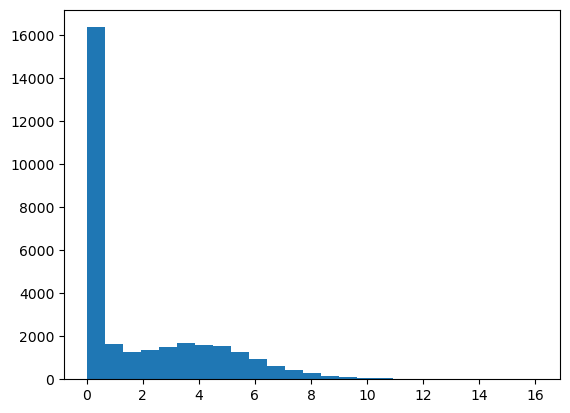

In [51]:
plt.hist(cnt_lst[2], bins = 25)

(array([1.7041e+04, 1.4470e+03, 1.1490e+03, 1.1710e+03, 1.3340e+03,
        1.5170e+03, 1.5270e+03, 1.4360e+03, 1.2130e+03, 8.7700e+02,
        6.6200e+02, 5.0900e+02, 3.5200e+02, 1.8600e+02, 1.4300e+02,
        8.8000e+01, 7.1000e+01, 4.4000e+01, 4.1000e+01, 3.7000e+01,
        2.0000e+01, 1.4000e+01, 3.0000e+00, 4.0000e+00, 2.0000e+00]),
 array([ 0.        ,  0.57982671,  1.15965341,  1.73948012,  2.31930683,
         2.89913354,  3.47896024,  4.05878695,  4.63861366,  5.21844037,
         5.79826707,  6.37809378,  6.95792049,  7.5377472 ,  8.1175739 ,
         8.69740061,  9.27722732,  9.85705403, 10.43688073, 11.01670744,
        11.59653415, 12.17636085, 12.75618756, 13.33601427, 13.91584098,
        14.49566768]),
 <BarContainer object of 25 artists>)

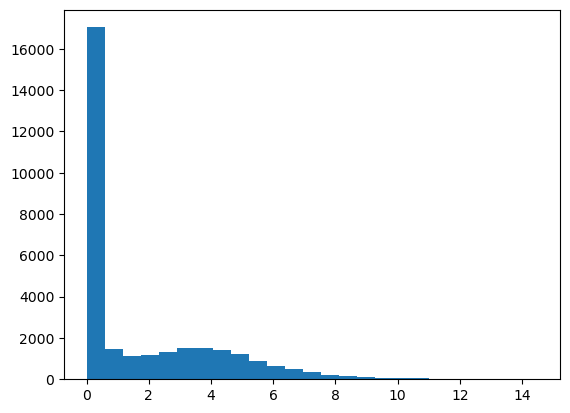

In [52]:
plt.hist(cnt_lst[3], bins = 25)

In [36]:
unq = list(exp_df.improve_sample_id.unique())

In [40]:
unq[-5:]

[1299, 1314, 1315, 1316, 1317]

1299


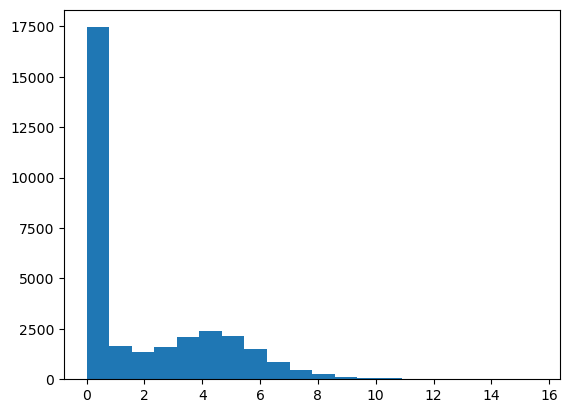

1314


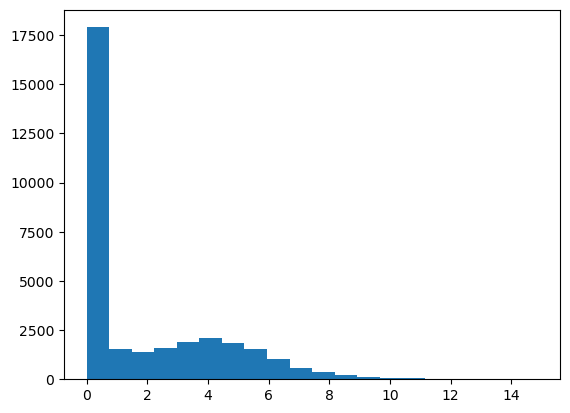

1315


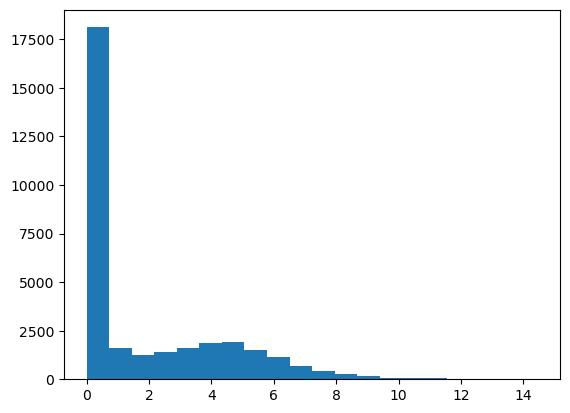

1316


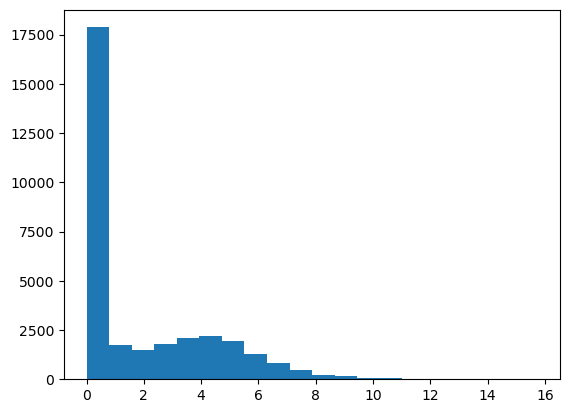

1317


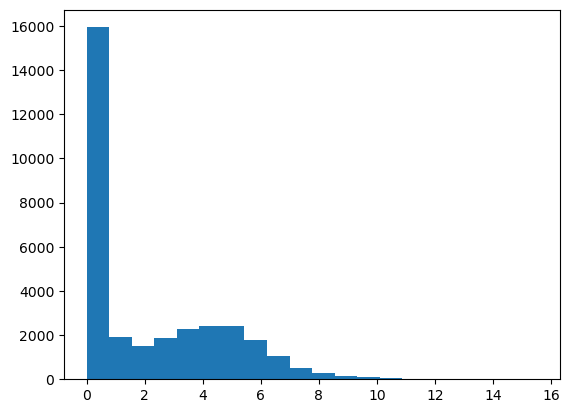

In [54]:
check_list = []
cnt_lst = []
for i, imprv_id in enumerate([1299, 1314, 1315, 1316, 1317]):
    print(imprv_id)
    sub = exp_df[exp_df.improve_sample_id == imprv_id]
    # print(len(sub))
    # break
    check_list.append(list(sub.entrez_id))
    cnt_lst.append(list(sub.counts))
    plt.hist(cnt_lst[i], bins = 20)
    plt.show()

In [ ]:
# Observation: plausible similarity and differences in expression
# across Improve smaples

### Tissue type

In [55]:
file_path = 'samples.csv'
smp_df = pd.read_csv(file_path)

/var/folders/5v/88tvwqd94gs4dfr3h6rt1_w0qd13bg/T/ipykernel_72542/4208829601.py:2: DtypeWarning: Columns (0,1) have mixed types. Specify dtype option on import or set low_memory=False.
  smp_df = pd.read_csv(file_path)


In [56]:
smp_df

,common_name,cancer_type,other_names,species,improve_sample_id,id_source,other_id,model_type
0,SLR 21,Clear cell renal cell carcinoma,SLR21,Homo sapiens (Human),1,DepMap,ACH-000016,cell line
1,SLR 21,Clear cell renal cell carcinoma,SLR21,Homo sapiens (Human),1,CCLE,SLR21_KIDNEY,cell line
2,SLR 21,Clear cell renal cell carcinoma,SLR21,Homo sapiens (Human),1,Cellosaurus,CVCL_V607,cell line
3,SLR 21,Clear cell renal cell carcinoma,SLR 21,Homo sapiens (Human),1,DepMap,ACH-000016,cell line
4,SLR 21,Clear cell renal cell carcinoma,SLR 21,Homo sapiens (Human),1,CCLE,SLR21_KIDNEY,cell line
...,...,...,...,...,...,...,...,...
217142,PSS131R,NaN,NaN,NaN,108158,CCLE,PSS131R_Osteosarcoma,cell line
217143,A375_RPMI,NaN,NaN,NaN,108159,DepMap,ACH-002874,cell line
217144,RVH421_RPMI,NaN,NaN,NaN,108160,DepMap,ACH-002875,cell line
217145,CHLA-57,NaN,NaN,NaN,108161,DepMap,ACH-001033,cell line


### Cancer type, id_source as y

In [66]:
len(smp_df.model_type.unique())

1

In [65]:
len(smp_df.other_id.unique())

115528

In [64]:
len(smp_df.id_source.unique())

7

In [63]:
len(smp_df.species.unique())

2

In [62]:
len(smp_df.other_names.unique())

184032

In [61]:
len(smp_df.common_name.unique())

1713

In [58]:
smp_df.cancer_type.unique()

array(['Clear cell renal cell carcinoma',
       'Childhood B acute lymphoblastic leukemia', 'Lung adenocarcinoma',
       'Melanoma', nan, 'Rhabdomyosarcoma', 'Mantle cell lymphoma',
       'Malignancy in giant cell tumor of bone',
       'Chronic myelogenous leukemia, BCR-ABL1 positive',
       'Primary cutaneous T-cell non-Hodgkin lymphoma',
       'Acute myeloid leukemia with inv(3) (q21.3q26.2) or t(33) (q21.3q26.2) GATA2, MECOM',
       'Colon adenocarcinoma', 'Pancreatic ductal adenocarcinoma',
       'Gastric carcinoma', 'Ewing sarcoma',
       'Adult T acute lymphoblastic leukemia', 'Hodgkin lymphoma',
       'B acute lymphoblastic leukemia',
       'Diffuse large B-cell lymphoma germinal center B-cell type',
       'Osteosarcoma',
       'Diffuse large B-cell lymphoma activated B-cell type',
       'Adult acute myeloid leukemia', 'Extrarenal rhabdoid tumor',
       'Endometrial adenocarcinoma', 'Lung small cell carcinoma',
       'Pancreatic carcinoma', 'Barrett adenocarcinom

In [60]:
len(smp_df.cancer_type.unique())

255

In [ ]:
# To AUC as y now then return to CPTAC for tissue y

### Transpose expression

In [67]:
%whos

Variable                Type         Data/Info
----------------------------------------------
check_list              list         n=5
cnt_lst                 list         n=5
collections             module       <module 'collections' fro<...>collections/__init__.py'>
exp_avrgd_chk           DataFrame                entrez_id  im<...>1104216 rows x 3 columns]
exp_df                  DataFrame                entrez_id  im<...>2481008 rows x 5 columns]
file_path               str          samples.csv
gene_vector_lens        list         n=1007
gene_vector_lens_dups   list         n=1007
gene_vectors            list         n=1007
i                       int          4
imprv_id                int          1317
keras                   module       <module 'keras.api._v2.ke<...>i/_v2/keras/__init__.py'>
layers                  module       <module 'keras.api._v2.ke<...>eras/layers/__init__.py'>
math                    module       <module 'math' from '/Use<...>th.cpython-39-darwin.so'>
np  

In [68]:
exp_avrgd_chk

,entrez_id,improve_sample_id,counts
0,8362.0,1,1.210693
1,8294.0,1,1.210693
2,554313.0,1,1.210693
3,121504.0,1,1.210693
4,8370.0,1,1.210693
...,...,...,...
31104211,54659.0,1317,0.000000
31104212,54579.0,1317,0.000000
31104213,474383.0,1317,0.000000
31104214,105377063.0,1317,0.000000


In [75]:
exprsn_dot_T = pd.DataFrame()
for smp_id in exp_avrgd_chk.improve_sample_id.unique():
    sub = exp_avrgd_chk[exp_avrgd_chk.improve_sample_id == smp_id]
    transposed_df = sub.pivot(index='improve_sample_id', columns='entrez_id', values='counts')
    exprsn_dot_T = pd.concat([exprsn_dot_T, transposed_df])
    # break

In [76]:
exprsn_dot_T.to_csv('disk_chkpnts_tssue/exprsn_dot_T.tsv',
                  sep = '\t')

In [77]:
exprsn_dot_T_read = pd.read_csv('disk_chkpnts_tssue/exprsn_dot_T.tsv',
                  sep = '\t', index_col = 0)

In [78]:
exprsn_dot_T_read

,1.0,2.0,3.0,9.0,10.0,12.0,13.0,14.0,15.0,16.0,...,122526777.0,122526779.0,122526780.0,122526782.0,122539212.0,122539214.0,123258399.0,124905743.0,124906461.0,125316803.0
improve_sample_id,,,,,,,,,,,,,,,,,,,,,
1,0.176323,0.097611,0.028569,1.773996,0.028569,0.286881,0.000000,6.595742,0.111031,6.307975,...,0.000000,1.077243,0.669027,2.070389,1.903038,0.782409,5.059182,0.0,0.000000,5.139142
2,4.878235,1.263034,0.000000,3.198494,0.000000,0.028569,0.000000,6.758223,0.070389,7.322469,...,0.000000,0.000000,1.411426,2.771886,0.722466,3.539779,4.005400,0.0,0.000000,6.066089
3,4.453518,0.163499,0.000000,0.695994,0.464668,0.000000,0.056584,6.367022,0.097611,6.188045,...,0.000000,0.000000,0.632268,3.464668,2.003602,1.195348,5.587365,0.0,0.226509,5.005849
4,5.930264,2.625270,0.000000,3.327687,0.070389,0.584963,1.584963,5.984817,0.176323,4.789729,...,0.000000,0.000000,0.713696,3.094236,1.526069,1.883621,3.956057,0.0,0.014355,4.446918
5,3.716991,0.124328,0.000000,2.521051,0.238787,0.014355,0.000000,6.003152,0.042644,5.987093,...,0.000000,0.000000,0.555816,3.683696,1.891419,1.604071,4.515384,0.0,0.000000,4.755956
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1299,5.398145,3.883621,0.000000,2.247928,0.000000,3.234195,0.150560,6.209258,0.000000,6.302136,...,0.000000,3.983678,0.432959,4.168321,0.526069,1.056584,5.168321,0.0,0.000000,5.285772
1314,6.143026,0.084064,0.000000,1.599318,0.163499,0.275007,3.181103,6.717128,0.298658,6.716717,...,0.000000,0.000000,1.111031,2.650765,1.475085,2.253989,5.995937,0.0,0.000000,5.089583
1315,3.260026,0.475085,0.000000,1.937344,0.000000,2.952334,3.892391,6.513807,0.189034,6.268659,...,0.948601,0.000000,1.356144,2.950468,1.321928,2.516015,5.211012,0.0,0.000000,5.293518


In [79]:
del(exprsn_dot_T_read)

### Differential expression quant

In [94]:
dff_tup = []
for col_i in exprsn_dot_T:
    # print(col_i)
    dff_tup.append((col_i, exprsn_dot_T[col_i].max()-exprsn_dot_T[col_i].min()))
    # break

In [ ]:
dff_tup

In [96]:
sorted_tuples = sorted(dff_tup, key=lambda x: x[1])

In [99]:
sorted_tuples[-5:]

[(28825.0, 16.844644474067053),
 (3537.0, 16.939292244456748),
 (3514.0, 17.034680767454443),
 (28914.0, 17.03629168544082),
 (28816.0, 17.12192805149012)]

In [89]:
exprsn_dot_T[col_i].min()

0.0

In [90]:
exprsn_dot_T[col_i].max()

6.889716891615078

In [91]:
exprsn_dot_T[col_i].max()-exprsn_dot_T[col_i].min()

6.889716891615078

### Build summary AUC inner join object

In [ ]:
# from imprv_encod_v0.ipynb for 3.3M AUC to SMILES mapping

In [ ]:
file_path = 'genes.csv'
gns_df = pd.read_csv(file_path)

file_path = 'drugs.tsv.gz'
drg_df = pd.read_csv(file_path, sep = '\t')

file_path = 'samples.csv'
smp_df = pd.read_csv(file_path)

file_path = 'mutations.csv'
mut_df = pd.read_csv(file_path)
# ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~ small/big file cutoff point
file_path = 'experiments.tsv.gz'
xpr_df = pd.read_csv(file_path, sep = '\t')

file_path = 'copy_number.csv.gz'
cn_df = pd.read_csv(file_path)

file_path = 'expression.csv.gz'
exp_df = pd.read_csv(file_path)

In [ ]:
# Get relevant mapping and initial learnable field from experiments file
xpr_auc = xpr_df[['improve_sample_id', 'improve_drug_id', 'AUC']].copy()
xpr_auc

In [ ]:
xpr_check = xpr_auc[['improve_sample_id', 'improve_drug_id']].copy() # Begin inner join route

In [ ]:
xpr_check.drop_duplicates(inplace = True)

In [ ]:
unq_pairs = xpr_auc[xpr_auc["index"].isin(xpr_check["index"])]

### Read the AUC inner join for devel y and categorical X

In [ ]:
# ~~~~~~~~~~~~~~~~~~~~~~~ resume devel flow

In [80]:
inner_join_AUC = pd.read_csv('disk_checkpoints/inner_join_AUC.tsv', sep = '\t',
                            index_col = 0)

In [81]:
inner_join_AUC

,improve_sample_id,improve_drug_id,AUC,canSMILES
0,4.0,PC_10127622,0.9375,CN1C=NC2=C1C=C(C(=C2F)NC3=C(C=C(C=C3)Br)Cl)C(=...
1,6.0,PC_10127622,0.6818,CN1C=NC2=C1C=C(C(=C2F)NC3=C(C=C(C=C3)Br)Cl)C(=...
2,10.0,PC_10127622,0.7154,CN1C=NC2=C1C=C(C(=C2F)NC3=C(C=C(C=C3)Br)Cl)C(=...
3,11.0,PC_10127622,0.9215,CN1C=NC2=C1C=C(C(=C2F)NC3=C(C=C(C=C3)Br)Cl)C(=...
4,21.0,PC_10127622,0.9301,CN1C=NC2=C1C=C(C(=C2F)NC3=C(C=C(C=C3)Br)Cl)C(=...
...,...,...,...,...
3378703,93445.0,PC_9889366,0.8154,CC(C)S(=O)(=O)NCC(C)C1=CC=C(C=C1)C2=CC=C(C=C2)...
3378704,96468.0,PC_9889366,0.8303,CC(C)S(=O)(=O)NCC(C)C1=CC=C(C=C1)C2=CC=C(C=C2)...
3378705,96932.0,PC_9889366,2.6670,CC(C)S(=O)(=O)NCC(C)C1=CC=C(C=C1)C2=CC=C(C=C2)...
3378706,104830.0,PC_9889366,0.9535,CC(C)S(=O)(=O)NCC(C)C1=CC=C(C=C1)C2=CC=C(C=C2)...


In [83]:
len(inner_join_AUC.improve_sample_id.unique())

1401

### Diff exprssn quant subset

In [102]:
exprsn_dot_T

entrez_id,1.0,2.0,3.0,9.0,10.0,12.0,13.0,14.0,15.0,16.0,...,122526777.0,122526779.0,122526780.0,122526782.0,122539212.0,122539214.0,123258399.0,124905743.0,124906461.0,125316803.0
improve_sample_id,,,,,,,,,,,,,,,,,,,,,
1,0.176323,0.097611,0.028569,1.773996,0.028569,0.286881,0.000000,6.595742,0.111031,6.307975,...,0.000000,1.077243,0.669027,2.070389,1.903038,0.782409,5.059182,0.0,0.000000,5.139142
2,4.878235,1.263034,0.000000,3.198494,0.000000,0.028569,0.000000,6.758223,0.070389,7.322469,...,0.000000,0.000000,1.411426,2.771886,0.722466,3.539779,4.005400,0.0,0.000000,6.066089
3,4.453518,0.163499,0.000000,0.695994,0.464668,0.000000,0.056584,6.367022,0.097611,6.188045,...,0.000000,0.000000,0.632268,3.464668,2.003602,1.195348,5.587365,0.0,0.226509,5.005849
4,5.930264,2.625270,0.000000,3.327687,0.070389,0.584963,1.584963,5.984817,0.176323,4.789729,...,0.000000,0.000000,0.713696,3.094236,1.526069,1.883621,3.956057,0.0,0.014355,4.446918
5,3.716991,0.124328,0.000000,2.521051,0.238787,0.014355,0.000000,6.003152,0.042644,5.987093,...,0.000000,0.000000,0.555816,3.683696,1.891419,1.604071,4.515384,0.0,0.000000,4.755956
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1299,5.398145,3.883621,0.000000,2.247928,0.000000,3.234195,0.150560,6.209258,0.000000,6.302136,...,0.000000,3.983678,0.432959,4.168321,0.526069,1.056584,5.168321,0.0,0.000000,5.285772
1314,6.143026,0.084064,0.000000,1.599318,0.163499,0.275007,3.181103,6.717128,0.298658,6.716717,...,0.000000,0.000000,1.111031,2.650765,1.475085,2.253989,5.995937,0.0,0.000000,5.089583
1315,3.260026,0.475085,0.000000,1.937344,0.000000,2.952334,3.892391,6.513807,0.189034,6.268659,...,0.948601,0.000000,1.356144,2.950468,1.321928,2.516015,5.211012,0.0,0.000000,5.293518


In [105]:
len(sorted_tuples[-100:])

100

In [107]:
sorted_tuples[-100:]

[(7033.0, 12.79960542245267),
 (4232.0, 12.831170191618138),
 (3855.0, 12.832296678749884),
 (2168.0, 12.86822452247007),
 (6282.0, 12.871256798953562),
 (3488.0, 12.876094819776162),
 (7070.0, 12.881534621648768),
 (1646.0, 12.898147876096942),
 (3817.0, 12.9336722154806),
 (972.0, 12.954156282409246),
 (1392.0, 12.98231626143452),
 (5265.0, 12.999542040712294),
 (28442.0, 13.018826091974384),
 (5054.0, 13.03797177101524),
 (216.0, 13.052759703382309),
 (100887749.0, 13.072467608241858),
 (28930.0, 13.08520686730997),
 (4502.0, 13.158607963895982),
 (6285.0, 13.159351040430542),
 (3002.0, 13.178073461352406),
 (6275.0, 13.185906290160391),
 (354.0, 13.187815987146577),
 (28935.0, 13.202873756823214),
 (6361.0, 13.20789895068418),
 (7045.0, 13.220877077773258),
 (10631.0, 13.265864068611467),
 (28567.0, 13.28572008539366),
 (3856.0, 13.297703213612042),
 (28797.0, 13.331896637093454),
 (174.0, 13.33385416119417),
 (28908.0, 13.35837648032824),
 (3880.0, 13.36755126021612),
 (28452.0, 1

In [109]:
columns_to_keep = [t[0] for t in sorted_tuples[-100:]]

In [111]:
type(columns_to_keep)

list

In [112]:
columns_to_keep[0]

7033.0

In [113]:
type(columns_to_keep[0])

float

In [114]:
exprsn_dot_T.columns[0]

1.0

In [115]:
type(exprsn_dot_T.columns[0])

numpy.float64

In [116]:
filtered_df = exprsn_dot_T[columns_to_keep]

In [117]:
filtered_df

entrez_id,7033.0,4232.0,3855.0,2168.0,6282.0,3488.0,7070.0,1646.0,3817.0,972.0,...,28803.0,28822.0,28893.0,3048.0,28815.0,28825.0,3537.0,3514.0,28914.0,28816.0
improve_sample_id,,,,,,,,,,,,,,,,,,,,,
1,0.124328,0.124328,2.575312,0.000000,10.683960,1.350497,0.250962,9.954051,0.000000,6.120186,...,0.000000,2.169925,0.000000,0.000000,2.435629,0.000000,0.669027,1.959770,2.659925,0.000000
2,0.344828,0.163499,1.835924,0.000000,3.982765,0.163499,0.722466,1.207893,0.000000,10.613882,...,2.776104,3.073820,0.956057,0.495695,1.042644,0.250962,0.000000,5.391287,0.485427,2.173127
3,0.000000,6.013239,3.349082,0.111031,10.502633,5.465974,0.263034,0.111031,0.000000,0.622930,...,0.000000,1.286881,0.000000,0.111031,2.500802,0.000000,1.117695,1.378512,2.629939,0.000000
4,0.443607,4.814550,5.097611,0.250962,10.337287,10.327665,9.513155,2.675816,0.000000,2.931683,...,0.000000,0.000000,0.150560,0.604071,0.000000,0.000000,0.704872,3.502076,0.000000,0.000000
5,0.042644,5.451211,7.381024,0.097611,9.679867,7.232565,6.475733,0.555816,0.000000,6.339137,...,0.000000,2.111031,0.000000,0.475085,2.253989,0.000000,0.863938,1.443607,3.065228,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1299,0.933573,2.443607,2.863938,0.000000,8.752581,5.116032,1.970854,2.981853,0.000000,7.250583,...,1.130931,0.000000,0.000000,1.176323,0.613532,0.000000,0.226509,4.125155,0.000000,0.000000
1314,0.575312,2.563158,5.225352,0.000000,10.407799,3.147307,0.367371,1.871844,0.000000,1.454176,...,0.000000,0.000000,2.430285,0.485427,1.799087,0.000000,0.000000,2.319040,0.000000,0.084064
1315,0.526069,2.845992,10.787576,0.000000,9.341986,5.377124,0.124328,1.021480,0.111031,1.669027,...,0.000000,0.000000,2.666757,2.722466,1.843984,0.000000,0.000000,3.292782,0.000000,0.000000


In [118]:
inner_join_AUC

,improve_sample_id,improve_drug_id,AUC,canSMILES
0,4.0,PC_10127622,0.9375,CN1C=NC2=C1C=C(C(=C2F)NC3=C(C=C(C=C3)Br)Cl)C(=...
1,6.0,PC_10127622,0.6818,CN1C=NC2=C1C=C(C(=C2F)NC3=C(C=C(C=C3)Br)Cl)C(=...
2,10.0,PC_10127622,0.7154,CN1C=NC2=C1C=C(C(=C2F)NC3=C(C=C(C=C3)Br)Cl)C(=...
3,11.0,PC_10127622,0.9215,CN1C=NC2=C1C=C(C(=C2F)NC3=C(C=C(C=C3)Br)Cl)C(=...
4,21.0,PC_10127622,0.9301,CN1C=NC2=C1C=C(C(=C2F)NC3=C(C=C(C=C3)Br)Cl)C(=...
...,...,...,...,...
3378703,93445.0,PC_9889366,0.8154,CC(C)S(=O)(=O)NCC(C)C1=CC=C(C=C1)C2=CC=C(C=C2)...
3378704,96468.0,PC_9889366,0.8303,CC(C)S(=O)(=O)NCC(C)C1=CC=C(C=C1)C2=CC=C(C=C2)...
3378705,96932.0,PC_9889366,2.6670,CC(C)S(=O)(=O)NCC(C)C1=CC=C(C=C1)C2=CC=C(C=C2)...
3378706,104830.0,PC_9889366,0.9535,CC(C)S(=O)(=O)NCC(C)C1=CC=C(C=C1)C2=CC=C(C=C2)...


In [119]:
inner_join_AUC.set_index('improve_sample_id', inplace=True)

In [120]:
del inner_join_AUC['improve_drug_id']

In [121]:
inner_join_AUC

,AUC,canSMILES
improve_sample_id,,
4.0,0.9375,CN1C=NC2=C1C=C(C(=C2F)NC3=C(C=C(C=C3)Br)Cl)C(=...
6.0,0.6818,CN1C=NC2=C1C=C(C(=C2F)NC3=C(C=C(C=C3)Br)Cl)C(=...
10.0,0.7154,CN1C=NC2=C1C=C(C(=C2F)NC3=C(C=C(C=C3)Br)Cl)C(=...
11.0,0.9215,CN1C=NC2=C1C=C(C(=C2F)NC3=C(C=C(C=C3)Br)Cl)C(=...
21.0,0.9301,CN1C=NC2=C1C=C(C(=C2F)NC3=C(C=C(C=C3)Br)Cl)C(=...
...,...,...
93445.0,0.8154,CC(C)S(=O)(=O)NCC(C)C1=CC=C(C=C1)C2=CC=C(C=C2)...
96468.0,0.8303,CC(C)S(=O)(=O)NCC(C)C1=CC=C(C=C1)C2=CC=C(C=C2)...
96932.0,2.6670,CC(C)S(=O)(=O)NCC(C)C1=CC=C(C=C1)C2=CC=C(C=C2)...


### Transformer

In [122]:
merged_df = inner_join_AUC.merge(filtered_df, left_index=True, right_index=True)

In [123]:
merged_df

,AUC,canSMILES,7033.0,4232.0,3855.0,2168.0,6282.0,3488.0,7070.0,1646.0,...,28803.0,28822.0,28893.0,3048.0,28815.0,28825.0,3537.0,3514.0,28914.0,28816.0
improve_sample_id,,,,,,,,,,,,,,,,,,,,,
2.0,0.6668,CN1C=NC2=C1C=C(C(=C2F)NC3=C(C=C(C=C3)Br)Cl)C(=...,0.344828,0.163499,1.835924,0.0,3.982765,0.163499,0.722466,1.207893,...,2.776104,3.07382,0.956057,0.495695,1.042644,0.250962,0.0,5.391287,0.485427,2.173127
2.0,0.8804,CN1CCN(CC1)CCOC2=CC3=C(C(=C2)OC4CCOCC4)C(=NC=N...,0.344828,0.163499,1.835924,0.0,3.982765,0.163499,0.722466,1.207893,...,2.776104,3.07382,0.956057,0.495695,1.042644,0.250962,0.0,5.391287,0.485427,2.173127
2.0,0.7078,CC(C)OC1=C(C=CC(=C1)OC)C2=NC(C(N2C(=O)N3CCNC(=...,0.344828,0.163499,1.835924,0.0,3.982765,0.163499,0.722466,1.207893,...,2.776104,3.07382,0.956057,0.495695,1.042644,0.250962,0.0,5.391287,0.485427,2.173127
2.0,0.7176,CC(C1=C(C=CC(=C1Cl)F)Cl)OC2=C(N=CC(=C2)C3=CN(N...,0.344828,0.163499,1.835924,0.0,3.982765,0.163499,0.722466,1.207893,...,2.776104,3.07382,0.956057,0.495695,1.042644,0.250962,0.0,5.391287,0.485427,2.173127
2.0,0.0000,CN1C2=C(C=C(C=C2)OC3=CC(=NC=C3)C4=NC=C(N4)C(F)...,0.344828,0.163499,1.835924,0.0,3.982765,0.163499,0.722466,1.207893,...,2.776104,3.07382,0.956057,0.495695,1.042644,0.250962,0.0,5.391287,0.485427,2.173127
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97123.0,0.9609,CC1=C(C=CN=C1CS(=O)C2=NC3=CC=CC=C3N2)OCCCOC,0.000000,0.389567,3.489286,0.0,9.277427,0.137504,2.350497,1.144046,...,0.000000,0.00000,0.000000,0.495695,0.000000,0.000000,0.0,0.000000,0.000000,0.000000
97123.0,0.9518,C[N+](C)(C)CCOC(=O)N.[Cl-],0.000000,0.389567,3.489286,0.0,9.277427,0.137504,2.350497,1.144046,...,0.000000,0.00000,0.000000,0.495695,0.000000,0.000000,0.0,0.000000,0.000000,0.000000
97123.0,0.9576,C1CC(=O)NC2=C1C=CC(=C2)OCCCCN3CCN(CC3)C4=C(C(=...,0.000000,0.389567,3.489286,0.0,9.277427,0.137504,2.350497,1.144046,...,0.000000,0.00000,0.000000,0.495695,0.000000,0.000000,0.0,0.000000,0.000000,0.000000


In [ ]:
2 396 884 drug-cell line pairs

In [124]:
merged_df.to_csv('disk_checkpoints_AUC/merged_df_2.4M_AUC.tsv', sep = '\t')

In [144]:
del(plt)

In [145]:
import matplotlib.pyplot as plt

In [146]:
merged_df.AUC

improve_sample_id
2.0        0.6668
2.0        0.8804
2.0        0.7078
2.0        0.7176
2.0        0.0000
            ...  
97123.0    0.9609
97123.0    0.9518
97123.0    0.9576
97123.0    0.8134
97123.0    0.9360
Name: AUC, Length: 2396884, dtype: float64

TypeError: 'str' object is not callable

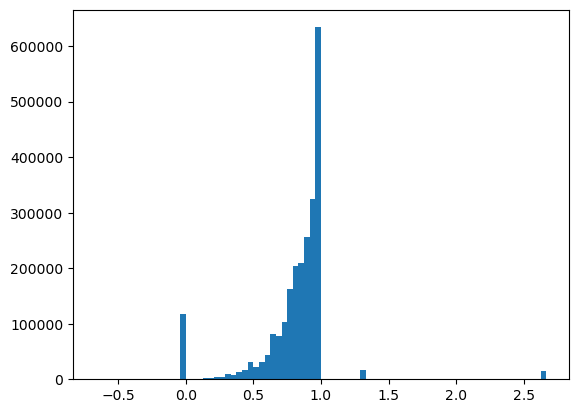

In [148]:
# Determining y-binning thresholds
plt.hist(merged_df.AUC, bins = 80)
plt.title('AUC, merged PhrmGx drg rspns')

In [ ]:
# class balance, confidence?

In [128]:
merged_df.isnull().sum().sum()

0

In [129]:
merged_df.AUC.min()

-0.6667

In [130]:
merged_df.AUC.max()

2.667

In [ ]:
>= edge case logic

In [155]:
trinary_list = []
for auc in merged_df.AUC:
    # print(auc)
    if auc > .85:
        trinary_list.append('high')
    elif auc < .6:
        trinary_list.append('low')
    else:
        trinary_list.append('med')
    # break

In [157]:
len(trinary_list)

2396884

In [158]:
merged_df.AUC = trinary_list

In [159]:
merged_df

,AUC,canSMILES,7033.0,4232.0,3855.0,2168.0,6282.0,3488.0,7070.0,1646.0,...,28803.0,28822.0,28893.0,3048.0,28815.0,28825.0,3537.0,3514.0,28914.0,28816.0
improve_sample_id,,,,,,,,,,,,,,,,,,,,,
2.0,med,CN1C=NC2=C1C=C(C(=C2F)NC3=C(C=C(C=C3)Br)Cl)C(=...,0.344828,0.163499,1.835924,0.0,3.982765,0.163499,0.722466,1.207893,...,2.776104,3.07382,0.956057,0.495695,1.042644,0.250962,0.0,5.391287,0.485427,2.173127
2.0,high,CN1CCN(CC1)CCOC2=CC3=C(C(=C2)OC4CCOCC4)C(=NC=N...,0.344828,0.163499,1.835924,0.0,3.982765,0.163499,0.722466,1.207893,...,2.776104,3.07382,0.956057,0.495695,1.042644,0.250962,0.0,5.391287,0.485427,2.173127
2.0,med,CC(C)OC1=C(C=CC(=C1)OC)C2=NC(C(N2C(=O)N3CCNC(=...,0.344828,0.163499,1.835924,0.0,3.982765,0.163499,0.722466,1.207893,...,2.776104,3.07382,0.956057,0.495695,1.042644,0.250962,0.0,5.391287,0.485427,2.173127
2.0,med,CC(C1=C(C=CC(=C1Cl)F)Cl)OC2=C(N=CC(=C2)C3=CN(N...,0.344828,0.163499,1.835924,0.0,3.982765,0.163499,0.722466,1.207893,...,2.776104,3.07382,0.956057,0.495695,1.042644,0.250962,0.0,5.391287,0.485427,2.173127
2.0,low,CN1C2=C(C=C(C=C2)OC3=CC(=NC=C3)C4=NC=C(N4)C(F)...,0.344828,0.163499,1.835924,0.0,3.982765,0.163499,0.722466,1.207893,...,2.776104,3.07382,0.956057,0.495695,1.042644,0.250962,0.0,5.391287,0.485427,2.173127
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97123.0,high,CC1=C(C=CN=C1CS(=O)C2=NC3=CC=CC=C3N2)OCCCOC,0.000000,0.389567,3.489286,0.0,9.277427,0.137504,2.350497,1.144046,...,0.000000,0.00000,0.000000,0.495695,0.000000,0.000000,0.0,0.000000,0.000000,0.000000
97123.0,high,C[N+](C)(C)CCOC(=O)N.[Cl-],0.000000,0.389567,3.489286,0.0,9.277427,0.137504,2.350497,1.144046,...,0.000000,0.00000,0.000000,0.495695,0.000000,0.000000,0.0,0.000000,0.000000,0.000000
97123.0,high,C1CC(=O)NC2=C1C=CC(=C2)OCCCCN3CCN(CC3)C4=C(C(=...,0.000000,0.389567,3.489286,0.0,9.277427,0.137504,2.350497,1.144046,...,0.000000,0.00000,0.000000,0.495695,0.000000,0.000000,0.0,0.000000,0.000000,0.000000


In [172]:
merged_df.canSMILES.value_counts()

CC1C(C(CC(O1)OC2CC(CC3=C2C(=C4C(=C3O)C(=O)C5=C(C4=O)C(=CC=C5)OC)O)(C(=O)CO)O)N)O                                          1596
CC(C1=C(C=CC(=C1Cl)F)Cl)OC2=C(N=CC(=C2)C3=CN(N=C3)C4CCNCC4)N                                                              1317
CN1C2C3=C(CCN2C(=O)C4=CC=CC=C41)C5=CC=CC=C5N3                                                                             1224
CC1CC2C3CCC4=CC(=O)C=CC4(C3(C(CC2(C1(C(=O)CO)O)C)O)F)C                                                                    1160
CC1CCC2CC(C(=CC=CC=CC(CC(C(=O)C(C(C(=CC(C(=O)CC(OC(=O)C3CCCCN3C(=O)C(=O)C1(O2)O)C(C)CC4CCC(C(C4)OC)O)C)C)O)OC)C)C)C)OC     919
                                                                                                                          ... 
CC1CCC(=C)C(C1(C)C)CCC(=CCCC2(C(C(=C(C)C=O)CCC2(C)O)CCCO)C)C                                                                11
C(=C(Cl)Cl)(C(=C(Cl)Br)Cl)[N+](=O)[O-]                                                                         

In [ ]:
# Idea: cut to most frequent drugs
    # or at least remove under-represented drugs < 100 samples

In [160]:
merged_df.to_csv('disk_checkpoints_AUC/merged_df_2.4M_AUC_trinary.tsv', sep = '\t')

In [ ]:
/Users/karlberb/Documents/work/pep_2_pro/two_pro_ten_pep.ipynb

In [188]:
merged_df

,AUC,canSMILES,7033.0,4232.0,3855.0,2168.0,6282.0,3488.0,7070.0,1646.0,...,28822.0,28893.0,3048.0,28815.0,28825.0,3537.0,3514.0,28914.0,28816.0,fnlwgt
improve_sample_id,,,,,,,,,,,,,,,,,,,,,
2.0,med,CN1C=NC2=C1C=C(C(=C2F)NC3=C(C=C(C=C3)Br)Cl)C(=...,0.344828,0.163499,1.835924,0.0,3.982765,0.163499,0.722466,1.207893,...,3.07382,0.956057,0.495695,1.042644,0.250962,0.0,5.391287,0.485427,2.173127,1.0
2.0,high,CN1CCN(CC1)CCOC2=CC3=C(C(=C2)OC4CCOCC4)C(=NC=N...,0.344828,0.163499,1.835924,0.0,3.982765,0.163499,0.722466,1.207893,...,3.07382,0.956057,0.495695,1.042644,0.250962,0.0,5.391287,0.485427,2.173127,1.0
2.0,med,CC(C)OC1=C(C=CC(=C1)OC)C2=NC(C(N2C(=O)N3CCNC(=...,0.344828,0.163499,1.835924,0.0,3.982765,0.163499,0.722466,1.207893,...,3.07382,0.956057,0.495695,1.042644,0.250962,0.0,5.391287,0.485427,2.173127,1.0
2.0,med,CC(C1=C(C=CC(=C1Cl)F)Cl)OC2=C(N=CC(=C2)C3=CN(N...,0.344828,0.163499,1.835924,0.0,3.982765,0.163499,0.722466,1.207893,...,3.07382,0.956057,0.495695,1.042644,0.250962,0.0,5.391287,0.485427,2.173127,1.0
2.0,low,CN1C2=C(C=C(C=C2)OC3=CC(=NC=C3)C4=NC=C(N4)C(F)...,0.344828,0.163499,1.835924,0.0,3.982765,0.163499,0.722466,1.207893,...,3.07382,0.956057,0.495695,1.042644,0.250962,0.0,5.391287,0.485427,2.173127,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97123.0,high,CC1=C(C=CN=C1CS(=O)C2=NC3=CC=CC=C3N2)OCCCOC,0.000000,0.389567,3.489286,0.0,9.277427,0.137504,2.350497,1.144046,...,0.00000,0.000000,0.495695,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,1.0
97123.0,high,C[N+](C)(C)CCOC(=O)N.[Cl-],0.000000,0.389567,3.489286,0.0,9.277427,0.137504,2.350497,1.144046,...,0.00000,0.000000,0.495695,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,1.0
97123.0,high,C1CC(=O)NC2=C1C=CC(=C2)OCCCCN3CCN(CC3)C4=C(C(=...,0.000000,0.389567,3.489286,0.0,9.277427,0.137504,2.350497,1.144046,...,0.00000,0.000000,0.495695,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,1.0


In [189]:
merged_df.columns

Index([      'AUC', 'canSMILES',      7033.0,      4232.0,      3855.0,
            2168.0,      6282.0,      3488.0,      7070.0,      1646.0,
       ...
           28822.0,     28893.0,      3048.0,     28815.0,     28825.0,
            3537.0,      3514.0,     28914.0,     28816.0,    'fnlwgt'],
      dtype='object', length=103)

In [190]:
merged_df.rename(
    columns={col: str(col) for col in merged_df.columns}, inplace=True)

In [191]:
merged_df.columns

Index(['AUC', 'canSMILES', '7033.0', '4232.0', '3855.0', '2168.0', '6282.0',
       '3488.0', '7070.0', '1646.0',
       ...
       '28822.0', '28893.0', '3048.0', '28815.0', '28825.0', '3537.0',
       '3514.0', '28914.0', '28816.0', 'fnlwgt'],
      dtype='object', length=103)

In [193]:
merged_df.to_csv('disk_checkpoints_AUC/merged_df_2.4M_AUC_trinary_str_cols.tsv', sep = '\t')

In [ ]:
# read-in here

In [19]:
merged_df = pd.read_csv('disk_checkpoints_AUC/merged_df_2.4M_AUC_trinary_str_cols.tsv',
                   sep = '\t', index_col = 0)

In [20]:
merged_df

,AUC,canSMILES,7033.0,4232.0,3855.0,2168.0,6282.0,3488.0,7070.0,1646.0,...,28822.0,28893.0,3048.0,28815.0,28825.0,3537.0,3514.0,28914.0,28816.0,fnlwgt
improve_sample_id,,,,,,,,,,,,,,,,,,,,,
2.0,med,CN1C=NC2=C1C=C(C(=C2F)NC3=C(C=C(C=C3)Br)Cl)C(=...,0.344828,0.163499,1.835924,0.0,3.982765,0.163499,0.722466,1.207893,...,3.07382,0.956057,0.495695,1.042644,0.250962,0.0,5.391287,0.485427,2.173127,1.0
2.0,high,CN1CCN(CC1)CCOC2=CC3=C(C(=C2)OC4CCOCC4)C(=NC=N...,0.344828,0.163499,1.835924,0.0,3.982765,0.163499,0.722466,1.207893,...,3.07382,0.956057,0.495695,1.042644,0.250962,0.0,5.391287,0.485427,2.173127,1.0
2.0,med,CC(C)OC1=C(C=CC(=C1)OC)C2=NC(C(N2C(=O)N3CCNC(=...,0.344828,0.163499,1.835924,0.0,3.982765,0.163499,0.722466,1.207893,...,3.07382,0.956057,0.495695,1.042644,0.250962,0.0,5.391287,0.485427,2.173127,1.0
2.0,med,CC(C1=C(C=CC(=C1Cl)F)Cl)OC2=C(N=CC(=C2)C3=CN(N...,0.344828,0.163499,1.835924,0.0,3.982765,0.163499,0.722466,1.207893,...,3.07382,0.956057,0.495695,1.042644,0.250962,0.0,5.391287,0.485427,2.173127,1.0
2.0,low,CN1C2=C(C=C(C=C2)OC3=CC(=NC=C3)C4=NC=C(N4)C(F)...,0.344828,0.163499,1.835924,0.0,3.982765,0.163499,0.722466,1.207893,...,3.07382,0.956057,0.495695,1.042644,0.250962,0.0,5.391287,0.485427,2.173127,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97123.0,high,CC1=C(C=CN=C1CS(=O)C2=NC3=CC=CC=C3N2)OCCCOC,0.000000,0.389567,3.489286,0.0,9.277427,0.137504,2.350497,1.144046,...,0.00000,0.000000,0.495695,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,1.0
97123.0,high,C[N+](C)(C)CCOC(=O)N.[Cl-],0.000000,0.389567,3.489286,0.0,9.277427,0.137504,2.350497,1.144046,...,0.00000,0.000000,0.495695,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,1.0
97123.0,high,C1CC(=O)NC2=C1C=CC(=C2)OCCCCN3CCN(CC3)C4=C(C(=...,0.000000,0.389567,3.489286,0.0,9.277427,0.137504,2.350497,1.144046,...,0.00000,0.000000,0.495695,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,1.0


In [ ]:
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

In [ ]:
# end data structure devel
# begin transformer test

In [ ]:
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

In [21]:
merged_df['fnlwgt'] = 1.

In [162]:
for i, col in enumerate(merged_df.columns):
    print(col)
    print(merged_df.iloc[0,i])
    print(type(merged_df.iloc[0,i]))
    print(' ')

AUC
med
<class 'str'>
 
canSMILES
CN1C=NC2=C1C=C(C(=C2F)NC3=C(C=C(C=C3)Br)Cl)C(=O)NOCCO
<class 'str'>
 
7033.0
0.3448284969974411
<class 'numpy.float64'>
 
4232.0
0.1634987322828795
<class 'numpy.float64'>
 
3855.0
1.835924074254375
<class 'numpy.float64'>
 
2168.0
0.0
<class 'numpy.float64'>
 
6282.0
3.982765462583646
<class 'numpy.float64'>
 
3488.0
0.1634987322828795
<class 'numpy.float64'>
 
7070.0
0.722466024471091
<class 'numpy.float64'>
 
1646.0
1.2078928516413328
<class 'numpy.float64'>
 
3817.0
0.0
<class 'numpy.float64'>
 
972.0
10.613881528863722
<class 'numpy.float64'>
 
1392.0
0.0
<class 'numpy.float64'>
 
5265.0
0.2265085298086797
<class 'numpy.float64'>
 
28442.0
0.1110313123887439
<class 'numpy.float64'>
 
5054.0
0.3561438102252753
<class 'numpy.float64'>
 
216.0
7.382234932751129
<class 'numpy.float64'>
 
100887749.0
2.104336659814736
<class 'numpy.float64'>
 
28930.0
0.7136958148433591
<class 'numpy.float64'>
 
4502.0
6.341985747228616
<class 'numpy.float64'>
 
6285.0

In [22]:
train_data = merged_df.sample(int(len(merged_df)*.75))
test_data = merged_df.loc[~merged_df.index.isin(train_data.index)]

In [165]:
pwd

'/Users/karlberb/Documents/work/Improve_data_files/data_may_23'

In [23]:
train_data_file = "train_data.csv"
test_data_file = "test_data.csv"

train_data.to_csv(train_data_file, index=False, header=False)
test_data.to_csv(test_data_file, index=False, header=False)

In [24]:
CSV_HEADER = merged_df.columns.to_list()

In [196]:
CSV_HEADER 

['AUC',
 'canSMILES',
 '7033.0',
 '4232.0',
 '3855.0',
 '2168.0',
 '6282.0',
 '3488.0',
 '7070.0',
 '1646.0',
 '3817.0',
 '972.0',
 '1392.0',
 '5265.0',
 '28442.0',
 '5054.0',
 '216.0',
 '100887749.0',
 '28930.0',
 '4502.0',
 '6285.0',
 '3002.0',
 '6275.0',
 '354.0',
 '28935.0',
 '6361.0',
 '7045.0',
 '10631.0',
 '28567.0',
 '3856.0',
 '28797.0',
 '174.0',
 '28908.0',
 '3880.0',
 '28452.0',
 '28784.0',
 '7431.0',
 '3507.0',
 '4353.0',
 '5270.0',
 '3875.0',
 '1278.0',
 '27121.0',
 '5225.0',
 '1277.0',
 '28933.0',
 '3486.0',
 '109910384.0',
 '336.0',
 '5552.0',
 '3852.0',
 '213.0',
 '4069.0',
 '28796.0',
 '4922.0',
 '6678.0',
 '3861.0',
 '106632260.0',
 '6696.0',
 '10551.0',
 '3512.0',
 '6277.0',
 '6286.0',
 '28785.0',
 '28439.0',
 '3495.0',
 '283120.0',
 '3538.0',
 '3500.0',
 '2335.0',
 '28874.0',
 '28793.0',
 '100008587.0',
 '109864274.0',
 '109864281.0',
 '109910381.0',
 '3934.0',
 '28813.0',
 '28817.0',
 '796.0',
 '3039.0',
 '28913.0',
 '28299.0',
 '3493.0',
 '3539.0',
 '4250.0',
 '2

In [ ]:
# TEMPLATE
NUMERIC_FEATURE_NAMES = ['charge', 'm_z', 'retention_time', # template
                         'retention_length', 'intensity',]

In [25]:
NUMERIC_FEATURE_NAMES = ['7033.0',
 '4232.0',
 '3855.0',
 '2168.0',
 '6282.0',
 '3488.0',
 '7070.0',
 '1646.0',
 '3817.0',
 '972.0',
 '1392.0',
 '5265.0',
 '28442.0',
 '5054.0',
 '216.0',
 '100887749.0',
 '28930.0',
 '4502.0',
 '6285.0',
 '3002.0',
 '6275.0',
 '354.0',
 '28935.0',
 '6361.0',
 '7045.0',
 '10631.0',
 '28567.0',
 '3856.0',
 '28797.0',
 '174.0',
 '28908.0',
 '3880.0',
 '28452.0',
 '28784.0',
 '7431.0',
 '3507.0',
 '4353.0',
 '5270.0',
 '3875.0',
 '1278.0',
 '27121.0',
 '5225.0',
 '1277.0',
 '28933.0',
 '3486.0',
 '109910384.0',
 '336.0',
 '5552.0',
 '3852.0',
 '213.0',
 '4069.0',
 '28796.0',
 '4922.0',
 '6678.0',
 '3861.0',
 '106632260.0',
 '6696.0',
 '10551.0',
 '3512.0',
 '6277.0',
 '6286.0',
 '28785.0',
 '28439.0',
 '3495.0',
 '283120.0',
 '3538.0',
 '3500.0',
 '2335.0',
 '28874.0',
 '28793.0',
 '100008587.0',
 '109864274.0',
 '109864281.0',
 '109910381.0',
 '3934.0',
 '28813.0',
 '28817.0',
 '796.0',
 '3039.0',
 '28913.0',
 '28299.0',
 '3493.0',
 '3539.0',
 '4250.0',
 '28473.0',
 '3040.0',
 '28823.0',
 '28912.0',
 '28457.0',
 '28878.0',
 '28803.0',
 '28822.0',
 '28893.0',
 '3048.0',
 '28815.0',
 '28825.0',
 '3537.0',
 '3514.0',
 '28914.0',
 '28816.0']

In [26]:
CATEGORICAL_FEATURES_WITH_VOCABULARY = { # One cat feat for this AUC test
    "canSMILES": sorted(list(train_data["canSMILES"].unique())),
}

In [27]:
WEIGHT_COLUMN_NAME = "fnlwgt"

In [28]:
TARGET_FEATURE_NAME = 'AUC'

In [29]:
COLUMN_DEFAULTS = [
    [0.0] if feature_name in NUMERIC_FEATURE_NAMES + [WEIGHT_COLUMN_NAME] else ["NA"]
    for feature_name in CSV_HEADER
]

In [30]:
TARGET_LABELS = merged_df.AUC.unique().tolist()

In [203]:
TARGET_LABELS

['med', 'high', 'low']

In [31]:
LEARNING_RATE = 0.001
WEIGHT_DECAY = 0.0001
DROPOUT_RATE = 0.2
BATCH_SIZE = 265
NUM_EPOCHS = 15

NUM_TRANSFORMER_BLOCKS = 3  # Number of transformer blocks.
NUM_HEADS = 4  # Number of attention heads.
EMBEDDING_DIMS = 16  # Embedding dimensions of the categorical features.
MLP_HIDDEN_UNITS_FACTORS = [
    2,
    1,
]  # MLP hidden layer units, as factors of the number of inputs.
NUM_MLP_BLOCKS = 2  # Number of MLP blocks in the baseline model.

In [32]:
target_label_lookup = layers.StringLookup(
    vocabulary=TARGET_LABELS, mask_token=None, num_oov_indices=0
)


def prepare_example(features, target):
    target_index = target_label_lookup(target)
    weights = features.pop(WEIGHT_COLUMN_NAME)
    return features, target_index, weights


def get_dataset_from_csv(csv_file_path, batch_size=128, shuffle=False):
    dataset = tf.data.experimental.make_csv_dataset(
        csv_file_path,
        batch_size=batch_size,
        column_names=CSV_HEADER,
        column_defaults=COLUMN_DEFAULTS,
        label_name=TARGET_FEATURE_NAME,
        num_epochs=1,
        header=False,
        na_value="?",
        shuffle=shuffle,
    ).map(prepare_example, num_parallel_calls=tf.data.AUTOTUNE, deterministic=False)
    return dataset.cache()

Metal device set to: Apple M1 Max


/Users/karlberb/miniforge3/envs/trnsfrmr/lib/python3.9/site-packages/numpy/core/numeric.py:2463: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  return bool(asarray(a1 == a2).all())
2023-07-07 09:12:01.596196: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-07-07 09:12:01.596652: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


In [33]:
def run_experiment(
    model,
    train_data_file,
    test_data_file,
    num_epochs,
    learning_rate,
    weight_decay,
    batch_size,
):

    optimizer = tfa.optimizers.AdamW(
        learning_rate=learning_rate, weight_decay=weight_decay
    )

    model.compile(
        optimizer=optimizer,
        loss=keras.losses.BinaryCrossentropy(),
        metrics=[keras.metrics.BinaryAccuracy(name="accuracy")],
    )

    train_dataset = get_dataset_from_csv(train_data_file, batch_size, shuffle=True)
    validation_dataset = get_dataset_from_csv(test_data_file, batch_size)

    print("Start training the model...")
    history = model.fit(
        train_dataset, epochs=num_epochs, validation_data=validation_dataset
    )
    print("Model training finished")

    _, accuracy = model.evaluate(validation_dataset, verbose=0)

    print(f"Validation accuracy: {round(accuracy * 100, 2)}%")

    return history

In [34]:
def create_model_inputs():
    inputs = {}
    for feature_name in FEATURE_NAMES:
        if feature_name in NUMERIC_FEATURE_NAMES:
            inputs[feature_name] = layers.Input(
                name=feature_name, shape=(), dtype=tf.float32
            )
        else:
            inputs[feature_name] = layers.Input(
                name=feature_name, shape=(), dtype=tf.string
            )
    return inputs

In [35]:
def encode_inputs(inputs, embedding_dims):

    encoded_categorical_feature_list = []
    numerical_feature_list = []

    for feature_name in inputs:
        if feature_name in CATEGORICAL_FEATURE_NAMES:

            # Get the vocabulary of the categorical feature.
            vocabulary = CATEGORICAL_FEATURES_WITH_VOCABULARY[feature_name]

            # Create a lookup to convert string values to an integer indices.
            # Since we are not using a mask token nor expecting any out of vocabulary
            # (oov) token, we set mask_token to None and  num_oov_indices to 0.
            lookup = layers.StringLookup(
                vocabulary=vocabulary,
                mask_token=None,
                num_oov_indices=0,
                output_mode="int",
            )

            # Convert the string input values into integer indices.
            encoded_feature = lookup(inputs[feature_name])

            # Create an embedding layer with the specified dimensions.
            embedding = layers.Embedding(
                input_dim=len(vocabulary), output_dim=embedding_dims
            )

            # Convert the index values to embedding representations.
            encoded_categorical_feature = embedding(encoded_feature)
            encoded_categorical_feature_list.append(encoded_categorical_feature)

        else:

            # Use the numerical features as-is.
            numerical_feature = tf.expand_dims(inputs[feature_name], -1)
            numerical_feature_list.append(numerical_feature)

    return encoded_categorical_feature_list, numerical_feature_list

In [40]:
def create_mlp(hidden_units, dropout_rate, activation, normalization_layer, name=None):

    mlp_layers = []
    for units in hidden_units:
        mlp_layers.append(normalization_layer),
        mlp_layers.append(layers.Dense(units, activation=activation))
        mlp_layers.append(layers.Dropout(dropout_rate))

    return keras.Sequential(mlp_layers, name=name)

In [36]:
CATEGORICAL_FEATURE_NAMES = list(CATEGORICAL_FEATURES_WITH_VOCABULARY.keys())

In [37]:
FEATURE_NAMES = NUMERIC_FEATURE_NAMES + CATEGORICAL_FEATURE_NAMES

In [212]:
def create_baseline_model(
    embedding_dims, num_mlp_blocks, mlp_hidden_units_factors, dropout_rate
):

    # Create model inputs.
    inputs = create_model_inputs()
    # encode features.
    encoded_categorical_feature_list, numerical_feature_list = encode_inputs(
        inputs, embedding_dims
    )
    # Concatenate all features.
    features = layers.concatenate(
        encoded_categorical_feature_list + numerical_feature_list
    )
    # Compute Feedforward layer units.
    feedforward_units = [features.shape[-1]]

    # Create several feedforwad layers with skip connections.
    for layer_idx in range(num_mlp_blocks):
        features = create_mlp(
            hidden_units=feedforward_units,
            dropout_rate=dropout_rate,
            activation=keras.activations.gelu,
            normalization_layer=layers.LayerNormalization(epsilon=1e-6),
            name=f"feedforward_{layer_idx}",
        )(features)

    # Compute MLP hidden_units.
    mlp_hidden_units = [
        factor * features.shape[-1] for factor in mlp_hidden_units_factors
    ]
    # Create final MLP.
    features = create_mlp(
        hidden_units=mlp_hidden_units,
        dropout_rate=dropout_rate,
        activation=keras.activations.selu,
        normalization_layer=layers.BatchNormalization(),
        name="MLP",
    )(features)

    # Add a sigmoid as a binary classifer.
    outputs = layers.Dense(units=1, activation="sigmoid", name="sigmoid")(features)
    model = keras.Model(inputs=inputs, outputs=outputs)
    return model


baseline_model = create_baseline_model(
    embedding_dims=EMBEDDING_DIMS,
    num_mlp_blocks=NUM_MLP_BLOCKS,
    mlp_hidden_units_factors=MLP_HIDDEN_UNITS_FACTORS,
    dropout_rate=DROPOUT_RATE,
)

print("Total model weights:", baseline_model.count_params())
keras.utils.plot_model(baseline_model, show_shapes=True, rankdir="LR")

Total model weights: 709193


In [ ]:
# note - transformer weights about 3.5x

In [ ]:
history = run_experiment(
    model=baseline_model,
    train_data_file=train_data_file,
    test_data_file=test_data_file,
    num_epochs=NUM_EPOCHS,
    learning_rate=LEARNING_RATE,
    weight_decay=WEIGHT_DECAY,
    batch_size=BATCH_SIZE,
)

Start training the model...
Epoch 1/15


2023-07-06 11:55:54.576737: W tensorflow/tsl/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2023-07-06 11:55:55.708695: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.
2023-07-06 11:56:05.928307: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:392] Filling up shuffle buffer (this may take a while): 4205 of 10000
2023-07-06 11:56:15.951451: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:392] Filling up shuffle buffer (this may take a while): 4594 of 10000
2023-07-06 11:56:25.917292: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:392] Filling up shuffle buffer (this may take a while): 4839 of 10000
2023-07-06 11:56:35.984926: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:392] Filling up shuffle buffer (this may take a while): 4943 of 10000
2023-07-06 11:56:45.927871: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:392] Filling up shuffle buffer (this may

   6784/Unknown - 839s 76ms/step - loss: -16837088.0000 - accuracy: 0.5463WARNING:tensorflow:`evaluate()` received a value for `sample_weight`, but `weighted_metrics` were not provided.  Did you mean to pass metrics to `weighted_metrics` in `compile()`?  If this is intentional you can pass `weighted_metrics=[]` to `compile()` in order to silence this warning.
6784/6784 [==============================] - 841s 76ms/step - loss: -16837088.0000 - accuracy: 0.5463
Epoch 2/15


2023-07-06 12:09:55.299152: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


3939/6784 [================>.............] - ETA: 2:53 - loss: -177689824.0000 - accuracy: 0.5147

In [ ]:
# Learning curves

In [ ]:
# from peptide version, add later

### Transfomer deploy

In [41]:
def create_tabtransformer_classifier(
    num_transformer_blocks,
    num_heads,
    embedding_dims,
    mlp_hidden_units_factors,
    dropout_rate,
    use_column_embedding=False,
):

    # Create model inputs.
    inputs = create_model_inputs()
    # encode features.
    encoded_categorical_feature_list, numerical_feature_list = encode_inputs(
        inputs, embedding_dims
    )
    # Stack categorical feature embeddings for the Tansformer.
    encoded_categorical_features = tf.stack(encoded_categorical_feature_list, axis=1)
    # Concatenate numerical features.
    numerical_features = layers.concatenate(numerical_feature_list)

    # Add column embedding to categorical feature embeddings.
    if use_column_embedding:
        num_columns = encoded_categorical_features.shape[1]
        column_embedding = layers.Embedding(
            input_dim=num_columns, output_dim=embedding_dims
        )
        column_indices = tf.range(start=0, limit=num_columns, delta=1)
        encoded_categorical_features = encoded_categorical_features + column_embedding(
            column_indices
        )

    # Create multiple layers of the Transformer block.
    for block_idx in range(num_transformer_blocks):
        # Create a multi-head attention layer.
        attention_output = layers.MultiHeadAttention(
            num_heads=num_heads,
            key_dim=embedding_dims,
            dropout=dropout_rate,
            name=f"multihead_attention_{block_idx}",
        )(encoded_categorical_features, encoded_categorical_features)
        # Skip connection 1.
        x = layers.Add(name=f"skip_connection1_{block_idx}")(
            [attention_output, encoded_categorical_features]
        )
        # Layer normalization 1.
        x = layers.LayerNormalization(name=f"layer_norm1_{block_idx}", epsilon=1e-6)(x)
        # Feedforward.
        feedforward_output = create_mlp(
            hidden_units=[embedding_dims],
            dropout_rate=dropout_rate,
            activation=keras.activations.gelu,
            normalization_layer=layers.LayerNormalization(epsilon=1e-6),
            name=f"feedforward_{block_idx}",
        )(x)
        # Skip connection 2.
        x = layers.Add(name=f"skip_connection2_{block_idx}")([feedforward_output, x])
        # Layer normalization 2.
        encoded_categorical_features = layers.LayerNormalization(
            name=f"layer_norm2_{block_idx}", epsilon=1e-6
        )(x)

    # Flatten the "contextualized" embeddings of the categorical features.
    categorical_features = layers.Flatten()(encoded_categorical_features)
    # Apply layer normalization to the numerical features.
    numerical_features = layers.LayerNormalization(epsilon=1e-6)(numerical_features)
    # Prepare the input for the final MLP block.
    features = layers.concatenate([categorical_features, numerical_features])

    # Compute MLP hidden_units.
    mlp_hidden_units = [
        factor * features.shape[-1] for factor in mlp_hidden_units_factors
    ]
    # Create final MLP.
    features = create_mlp(
        hidden_units=mlp_hidden_units,
        dropout_rate=dropout_rate,
        activation=keras.activations.selu,
        normalization_layer=layers.BatchNormalization(),
        name="MLP",
    )(features)

    # Add a sigmoid as a binary classifer.
    outputs = layers.Dense(units=1, activation="sigmoid", name="sigmoid")(features)
    model = keras.Model(inputs=inputs, outputs=outputs)
    return model


tabtransformer_model = create_tabtransformer_classifier(
    num_transformer_blocks=NUM_TRANSFORMER_BLOCKS,
    num_heads=NUM_HEADS,
    embedding_dims=EMBEDDING_DIMS,
    mlp_hidden_units_factors=MLP_HIDDEN_UNITS_FACTORS,
    dropout_rate=DROPOUT_RATE,
)

print("Total model weights:", tabtransformer_model.count_params())
keras.utils.plot_model(tabtransformer_model, show_shapes=True, rankdir="LR")

Total model weights: 695801


In [ ]:
# ^Observation: slightly less weights than MLP

In [ ]:
# Test transformer on 2.4M sample AUC/canSMILES/gene expression
history = run_experiment(
    model=tabtransformer_model,
    train_data_file=train_data_file,
    test_data_file=test_data_file,
    num_epochs=NUM_EPOCHS,
    learning_rate=LEARNING_RATE,
    weight_decay=WEIGHT_DECAY,
    batch_size=BATCH_SIZE,
)

Start training the model...
Epoch 1/15


2023-07-07 09:45:25.363697: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


   5175/Unknown - 569s 109ms/step - loss: -9762345.0000 - accuracy: 0.3579

In [ ]:
# Observation - failure to complete first training epoch
# Conclusion - 2.4M sample input to train/test split too large
# for practical devel with these models